In [54]:
import glob
from scipy.signal import convolve, boxcar
import scipy
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import numpy as np
import pandas as pd
import os, sys
import time
from astropy.table import Table
from astropy.io import fits
import copy
import scipy.io as spio
import matplotlib.image as mpimg


import astropy.constants as const
import astropy.units as u

#import CCF

# Read in Data, Model, and Tellurics

In [55]:
hdul = fits.open('s161106_a022002_Kbb_020.fits')
hdul.info()
cube = hdul[0].data

Filename: s161106_a022002_Kbb_020.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  SCI           1 PrimaryHDU     430   (1665, 64, 19)   float32   
  1                1 ImageHDU         8   (1665, 64, 19)   float32   
  2                1 ImageHDU         8   (1665, 64, 19)   uint8   


In [56]:
Wavelengths = hdul[0].header['CRVAL1'] + np.arange(hdul[0].header['NAXIS1']) * hdul[0].header['CDELT1']
#this is for OSIRIS

In [57]:
def load_osiris_cube(filename):
    """ Load OSIRIS cube 
    
    Returns (cube, wavelengths array, header)
    """
    hdul = fits.open(filename)
    hdul.info() 
    cube = hdul[0].data
   

    Wavelengths = hdul[0].header['CRVAL1'] + np.arange(hdul[0].header['NAXIS1']) * hdul[0].header['CDELT1']
    Wavelengths = Wavelengths #* u.nm
    return cube, Wavelengths, hdul[0].header


In [58]:
cube, Wavelengths, header = load_osiris_cube('s161106_a022002_Kbb_020.fits')

Filename: s161106_a022002_Kbb_020.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  SCI           1 PrimaryHDU     430   (1665, 64, 19)   float32   
  1                1 ImageHDU         8   (1665, 64, 19)   float32   
  2                1 ImageHDU         8   (1665, 64, 19)   uint8   


In [59]:
#convert Wavlengths to microns for consistency
Wavelengths = Wavelengths /1000 #*u.micron

Filename: HIP111538_aug5.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  SCI           1 PrimaryHDU     421   (1665,)   float32   


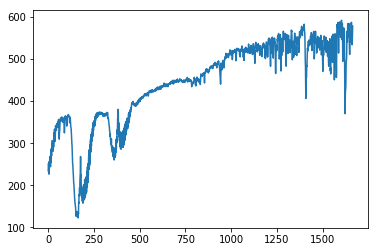

In [60]:
#Read in Tellurics
hdul = fits.open('HIP111538_aug5.fits')
hdul.info()
telluric = hdul[0].data
plt.plot(telluric)

In [61]:
#Read in model
t3 = np.genfromtxt('ccf_kappa_mod.txt')
cowaves = t3[:,0] #*u.micron
cofluxes = t3[:,1]
spline = scipy.interpolate.splrep(cowaves, cofluxes)

(1, 3)

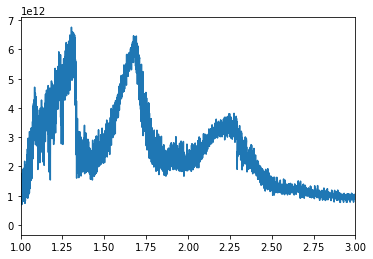

In [62]:
plt.plot(cowaves, cofluxes)
plt.xlim([1,3])

-14


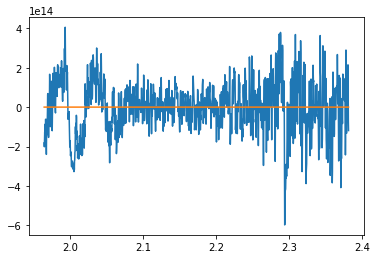

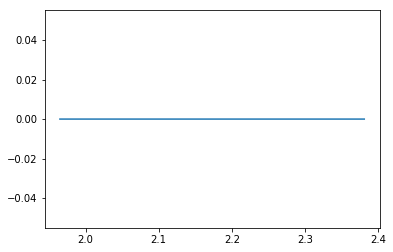

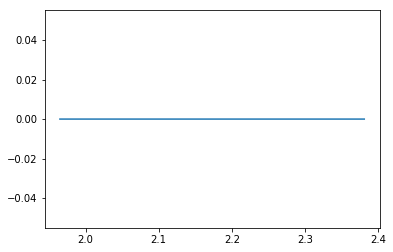

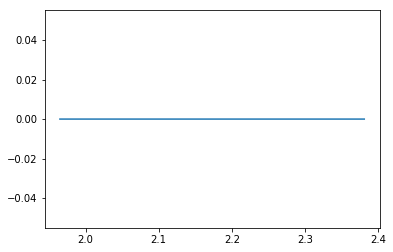

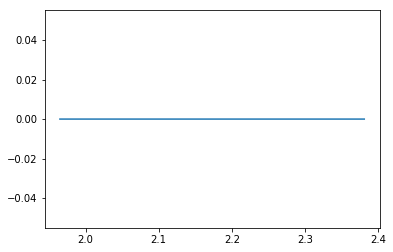

...

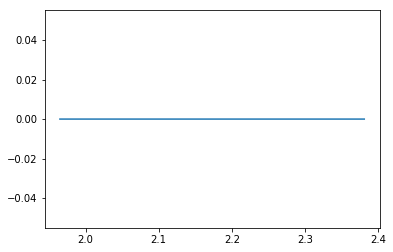

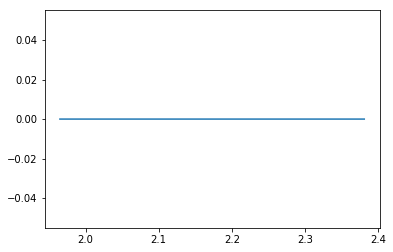

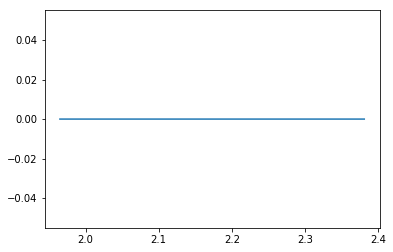

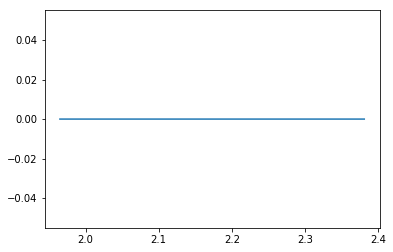

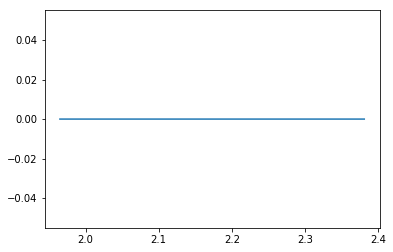

-13


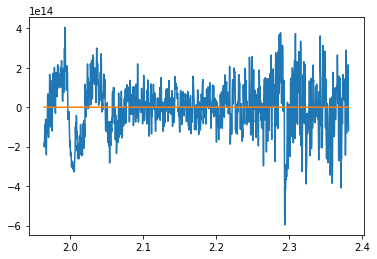

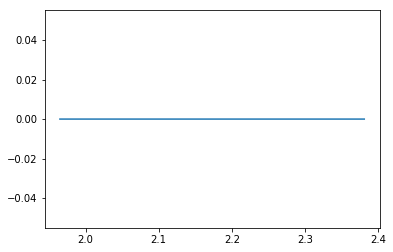

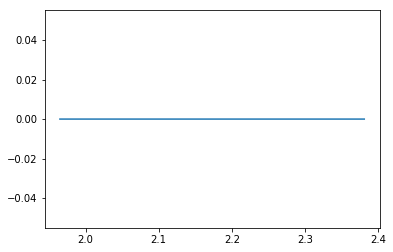

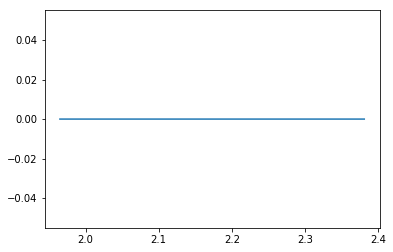

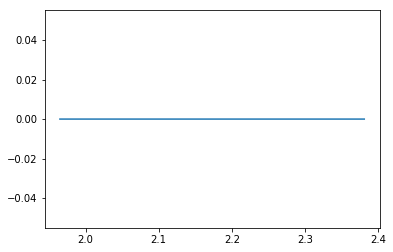

...

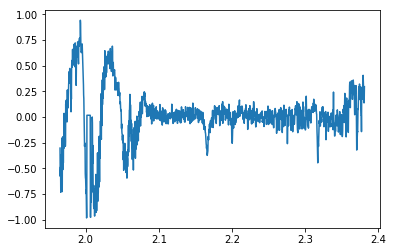

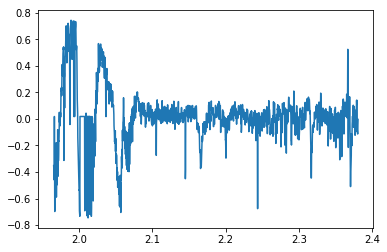

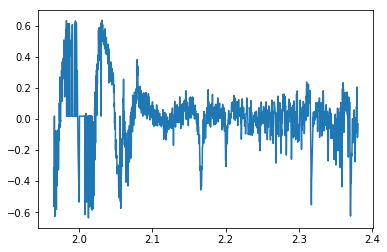

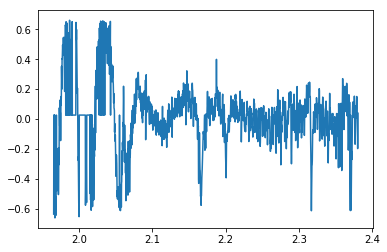

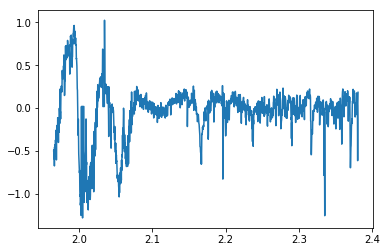

In [ ]:
#RV For Loop
corr_im = np.zeros((19,64,40))
#baryrv nov 6 2016 km/s: (need mjd-obs and to convert to JD)
baryrv = -10.3 #* u.km/u.second
#speed of light in km/s:
c_kms = 299792.458 #*u.km/u.second

for rv_id,rv in enumerate(range(-14,-12,1)):
    wvs_shifted= Wavelengths*(1 - ((rv-baryrv) / c_kms))
    #taking above model and creating a doppler shifted spectra of the model
    shifted_spec = scipy.interpolate.splev(wvs_shifted, spline, der=0)
    #Multiply model by telluric 
    model = shifted_spec * telluric
    #high pass filter model
    #smoothing the model spectra to get the continuum
    smoothedmod = scipy.ndimage.filters.uniform_filter(model,size=200)
    #subtracting the continuum out
    filtmod = model - smoothedmod
    #looping through cubes (0,18) (0,63)
    index = np.where(rv == 10)
    print(rv)
    plt.plot(Wavelengths, filtmod)
    for x in range(0,18):
        for y in range(0,63):
            #print(cube[x,y,:])
            smoothed=scipy.ndimage.filters.uniform_filter(cube[x,y,:],size=200) #smoothing pixel flux
            filt = cube[x,y,:] - smoothed #flatten the fluxes
            spikes = np.where(np.abs(filt) > 2*np.std(filt)) #locations in cube where spikes are, if getting rid of too much info set it higher to 3
            filt[spikes]=np.median(filt) #setting spikes to median value
            ccfval = np.sum(filt * filtmod) / np.sqrt(np.sum((filtmod) ** 2)) #cross correlate model with data
            plt.plot(Wavelengths, filt)
            plt.show()
            #print(ccfval)
            corr_im[x,y,rv_id] = ccfval   #put ccf value into array

plt.plot()
plt.figure(figsize=(15,5))
#plt.imshow(corr_im)
corr_im = corr_im - np.nanmedian(corr_im, axis=(0,1))
plt.imshow(corr_im[:,:,10])
plt.xlabel("Spaxels")
plt.ylabel("Spaxels")

cb = plt.colorbar()
cb.set_label("Cross Correlation Value")
plt.show()


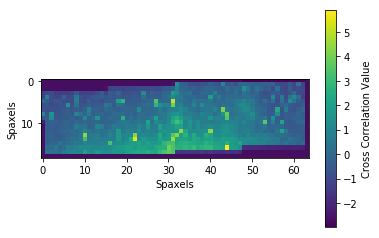

In [81]:
#corr_im = corr_im - np.nanmedian(corr_im, axis=(0,1))[None,None,:]
#index = np.where(rv == 10)
#print(index)
plt.imshow(corr_im[:,:,19])
plt.xlabel("Spaxels")
plt.ylabel("Spaxels")

cb = plt.colorbar()
cb.set_label("Cross Correlation Value")
plt.show()

In [10]:
#RV of Star km/s (go to simbad) Kappa And 
#rv = -12.7 * u.km/u.second
#baryrv nov 6 2016 km/s: (need mjd-obs and to convert to JD)
#baryrv = -10.3 * u.km/u.second
#speed of light in km/s:
#c_kms = 299792.458 *u.km/u.second

In [38]:
#assuming rv same as host star and keeping it constant, wavelengths = of the data itself
#wvs_shifted= Wavelengths*(1 - ((rv-baryrv) / c_kms))
#taking above model and creating a doppler shifted spectra of the model
#shifted_spec = scipy.interpolate.splev(wvs_shifted, spline, der=0)

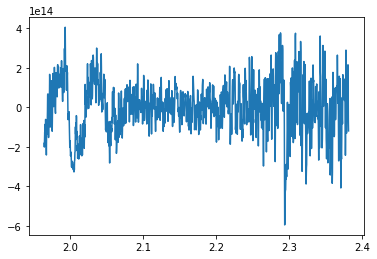

In [39]:
#Multiply model by telluric 
model = shifted_spec * telluric
#high pass filter model
#smoothing the model spectra to get the continuum
smoothedmod = scipy.ndimage.filters.uniform_filter(model,size=200)
#subtracting the continuum out
filtmod = model - smoothedmod
plt.plot(Wavelengths, filtmod)

In [40]:
#define array for 2d ccf image
#corr_im = np.zeros((19,64))


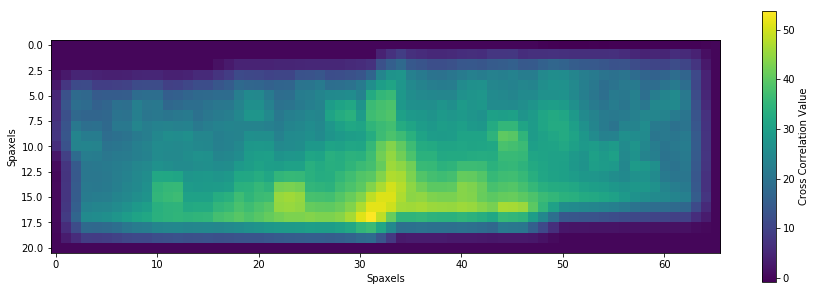

In [41]:
#looping through cubes (0,18) (0,63)
for x in range(0,18):
    for y in range(0,63):
        #print(cube[x,y,:])
        smoothed=scipy.ndimage.filters.uniform_filter(cube[x,y,:],size=200) #smoothing pixel flux
        filt = cube[x,y,:] - smoothed #flatten the fluxes
        spikes = np.where(np.abs(filt) > 2*np.std(filt)) #locations in cube where spikes are, if getting rid of too much info set it higher to 3
        filt[spikes]=np.median(filt) #setting spikes to median value
        ccfval = np.sum(filt * filtmod) / np.sqrt(np.sum((filtmod) ** 2)) #cross correlate model with data
        #print(ccfval)
        corr_im[x,y] = ccfval   #put ccf value into array
        #plt.plot(Wavelengths, filt)
        #plt.show()
        #print(spikes)
        
        

corr_im = scipy.signal.correlate2d(corr_im, np.ones((3,3)))
plt.figure(figsize=(15,5))
plt.imshow(corr_im)
plt.xlabel("Spaxels")
plt.ylabel("Spaxels")

cb = plt.colorbar()
cb.set_label("Cross Correlation Value")
plt.show()
